In [18]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

In [19]:
df = pd.read_csv('Band Defect Data.csv')

print("=== DATASET OVERVIEW ===")
print(f"Dataset shape: {df.shape}")
print(f"Number of welds: {len(df)}")
print(f"Memory usage: {df.memory_usage(deep=True).sum() / 1024**2:.2f} MB")

=== DATASET OVERVIEW ===
Dataset shape: (19663, 338)
Number of welds: 19663
Memory usage: 51.64 MB


In [20]:
def basic_dataset_info(df):
    """Comprehensive dataset overview"""
    
    print("=== BASIC DATASET INFORMATION ===")
    print(f"Shape: {df.shape} (rows, columns)")
    print(f"Columns: {list(df.columns)}")
    print("\nData Types:")
    print(df.dtypes.value_counts())
    
    print("\nMissing Values:")
    missing_info = df.isnull().sum()
    missing_percent = (missing_info / len(df)) * 100
    missing_df = pd.DataFrame({
        'Missing Count': missing_info,
        'Missing %': missing_percent
    })
    print(missing_df[missing_df['Missing Count'] > 0])
    
    print("\nDuplicate Rows:", df.duplicated().sum())
    
    # Target variable analysis
    if 'iDefect' in df.columns:
        print(f"\nTarget Variable (iDefect) Distribution:")
        target_counts = df['iDefect'].value_counts()
        target_percent = df['iDefect'].value_counts(normalize=True) * 100
        target_info = pd.DataFrame({
            'Count': target_counts,
            'Percentage': target_percent
        })
        print(target_info)

basic_dataset_info(df)

=== BASIC DATASET INFORMATION ===
Shape: (19663, 338) (rows, columns)
Columns: ['sSizeID', 'Actual_TransformerTemp', 'Actual_UpSettingPrs', 'Actual_Flash_1_Speed', 'Actual_Flash_2_Speed', 'Actual_OpenGap', 'Actual_Flash1Gap', 'Actual_Flash2Gap', 'Actual_UpSetting', 'ActualBedPostionUptoFlash1', 'ActualBedPositionAtFlash1', 'ActualBedPositionAtFlash2', 'ActualBedPositionAtUpSetting', 'ActualBedPostionUptoFlash1T', 'ActualBedPositionAtFlash1T', 'ActualBedPositionAtFlash2T', 'ActualBedPositionAtUpSettingT', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'C15', 'C16', 'C17', 'C18', 'C19', 'C20', 'C21', 'C22', 'C23', 'C24', 'C25', 'C26', 'C27', 'C28', 'C29', 'C30', 'C31', 'C32', 'C33', 'C34', 'C35', 'C36', 'C37', 'C38', 'C39', 'C40', 'C41', 'C42', 'C43', 'C44', 'C45', 'C46', 'C47', 'C48', 'C49', 'C50', 'C51', 'C52', 'C53', 'C54', 'C55', 'C56', 'C57', 'C58', 'C59', 'C60', 'C61', 'C62', 'C63', 'C64', 'C65', 'C66', 'C67', 'C68', 'C69', 'C70', 'C71', 'C

In [21]:
df.isnull().sum()

sSizeID                       0
Actual_TransformerTemp        0
Actual_UpSettingPrs           0
Actual_Flash_1_Speed          0
Actual_Flash_2_Speed          0
                          ...  
CPF77                      5994
CPF78                      8241
CPF79                     12006
CPF80                     14146
iDefect                       0
Length: 338, dtype: int64

In [22]:
df = df.fillna(0)

In [23]:
def analyze_static_parameters(df):
    """Detailed analysis of static welding parameters"""
    
    static_columns = [
        'Actual_TransformerTemp', 'Actual_UpSettingPrs', 'Actual_Flash_1_Speed',
        'Actual_Flash_2_Speed', 'Actual_OpenGap', 'Actual_Flash1Gap', 'Actual_Flash2Gap',
        'Actual_UpSetting', 'ActualBedPostionUptoFlash1', 'ActualBedPositionAtFlash1',
        'ActualBedPositionAtFlash2', 'ActualBedPositionAtUpSetting',
        'ActualBedPostionUptoFlash1T', 'ActualBedPositionAtFlash1T',
        'ActualBedPositionAtFlash2T', 'ActualBedPositionAtUpSettingT'
    ]
    
    categorical_columns = ['sSizeID']
    
    print("=== STATIC PARAMETERS ANALYSIS ===")
    
    # Numerical parameters
    static_stats = df[static_columns].describe()
    print("Statistical Summary of Static Parameters:")
    print(static_stats)
    
    # Categorical parameter
    if 'sSizeID' in df.columns:
        print(f"\nsSizeID Distribution:")
        print(df['sSizeID'].value_counts())
        print(f"Number of unique categories: {df['sSizeID'].nunique()}")
    
    return static_columns, categorical_columns

static_cols, cat_cols = analyze_static_parameters(df)

=== STATIC PARAMETERS ANALYSIS ===
Statistical Summary of Static Parameters:
       Actual_TransformerTemp  Actual_UpSettingPrs  Actual_Flash_1_Speed  \
count            19663.000000         19663.000000          19663.000000   
mean                43.037995            72.541067              5.429624   
std                  1.311753            38.504822              3.636612   
min                 39.200000             0.000000              0.000000   
25%                 42.200000            55.100000              0.300000   
50%                 43.000000            68.700000              6.800000   
75%                 43.900000            77.200000              7.700000   
max                 47.000000           148.400000            127.900000   

       Actual_Flash_2_Speed  Actual_OpenGap  Actual_Flash1Gap  \
count          19663.000000    19663.000000      19663.000000   
mean               5.475645       38.365997          1.287769   
std                3.146854        0.392847

In [24]:
def analyze_time_series_data(df):
    """Comprehensive analysis of time-series welding parameters"""
    
    print("=== TIME SERIES DATA ANALYSIS ===")
    
    # Extract time-series channels
    current_data = np.zeros((len(df), 80))
    cpl_data = np.zeros((len(df), 80))
    cpr_data = np.zeros((len(df), 80))
    cpf_data = np.zeros((len(df), 80))
    
    for i in range(1, 81):
        current_data[:, i-1] = df[f'C{i}'].values
        cpl_data[:, i-1] = df[f'CPL{i}'].values
        cpr_data[:, i-1] = df[f'CPR{i}'].values
        cpf_data[:, i-1] = df[f'CPF{i}'].values
    
    # Statistical analysis per channel
    channels = {
        'Current': current_data,
        'ClampPressure_Left': cpl_data,
        'ClampPressure_Right': cpr_data,
        'ClampPressure_Forward': cpf_data
    }
    
    print("Time Series Channel Statistics:")
    for name, data in channels.items():
        print(f"\n{name}:")
        print(f"  Shape: {data.shape}")
        print(f"  Global Mean: {np.mean(data):.2f}")
        print(f"  Global Std: {np.std(data):.2f}")
        print(f"  Min: {np.min(data):.2f}")
        print(f"  Max: {np.max(data):.2f}")
        print(f"  Range: {np.ptp(data):.2f}")
    
    return channels

channels = analyze_time_series_data(df)

=== TIME SERIES DATA ANALYSIS ===
Time Series Channel Statistics:

Current:
  Shape: (19663, 80)
  Global Mean: 454.80
  Global Std: 403.78
  Min: 0.00
  Max: 1619.20
  Range: 1619.20

ClampPressure_Left:
  Shape: (19663, 80)
  Global Mean: 30.44
  Global Std: 9.02
  Min: 0.00
  Max: 38.30
  Range: 38.30

ClampPressure_Right:
  Shape: (19663, 80)
  Global Mean: 31.53
  Global Std: 9.44
  Min: 0.00
  Max: 160.70
  Range: 160.70

ClampPressure_Forward:
  Shape: (19663, 80)
  Global Mean: 95.04
  Global Std: 32.54
  Min: 0.00
  Max: 158.70
  Range: 158.70


In [25]:
# --- Summary statistics ---
print("\nDescriptive statistics:\n", df.describe())


Descriptive statistics:
        Actual_TransformerTemp  Actual_UpSettingPrs  Actual_Flash_1_Speed  \
count            19663.000000         19663.000000          19663.000000   
mean                43.037995            72.541067              5.429624   
std                  1.311753            38.504822              3.636612   
min                 39.200000             0.000000              0.000000   
25%                 42.200000            55.100000              0.300000   
50%                 43.000000            68.700000              6.800000   
75%                 43.900000            77.200000              7.700000   
max                 47.000000           148.400000            127.900000   

       Actual_Flash_2_Speed  Actual_OpenGap  Actual_Flash1Gap  \
count          19663.000000    19663.000000      19663.000000   
mean               5.475645       38.365997          1.287769   
std                3.146854        0.392847          0.523742   
min                0.000000  


Target variable distribution:
iDefect
0    16692
1     2971
Name: count, dtype: int64


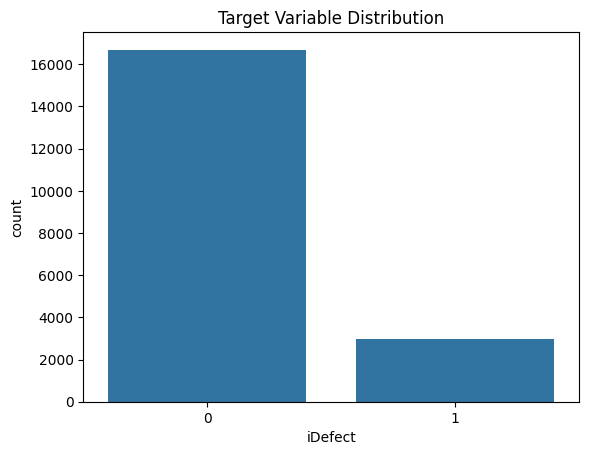

In [26]:
# --- Check class balance (for target variable) ---
if 'iDefect' in df.columns:
    print("\nTarget variable distribution:")
    print(df['iDefect'].value_counts())

    sns.countplot(x='iDefect', data=df)
    plt.title("Target Variable Distribution")
    plt.show()

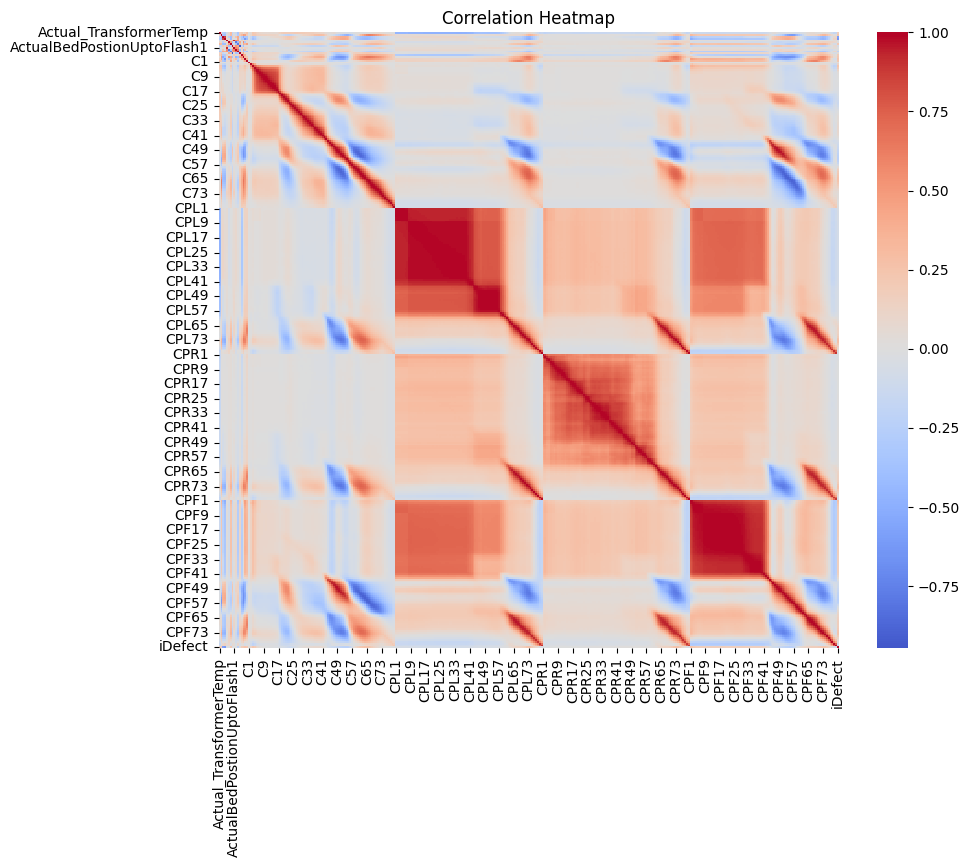

In [27]:
# --- Correlation analysis ---
corr = df.corr(numeric_only=True)
plt.figure(figsize=(10,8))
sns.heatmap(corr, cmap='coolwarm', center=0)
plt.title("Correlation Heatmap")
plt.show()

In [28]:
# --- Top correlated features with target ---
if 'iDefect' in df.columns:
    corr_target = corr['iDefect'].sort_values(ascending=False)
    print("\nTop correlated features with target:\n", corr_target.head(10))
    print("\nLeast correlated features with target:\n", corr_target.tail(10))


Top correlated features with target:
 iDefect    1.000000
CPF1       0.271565
CPR73      0.263153
CPL73      0.262399
C65        0.260652
CPL74      0.259959
CPR74      0.259906
C64        0.259579
CPF2       0.253591
CPF73      0.250685
Name: iDefect, dtype: float64

Least correlated features with target:
 CPF53                       -0.218234
C52                         -0.219727
ActualBedPositionAtFlash2   -0.221293
C54                         -0.224800
C53                         -0.225312
CPF56                       -0.227605
CPF54                       -0.231510
CPF55                       -0.239213
Actual_Flash_1_Speed        -0.587651
Actual_Flash_2_Speed        -0.627983
Name: iDefect, dtype: float64


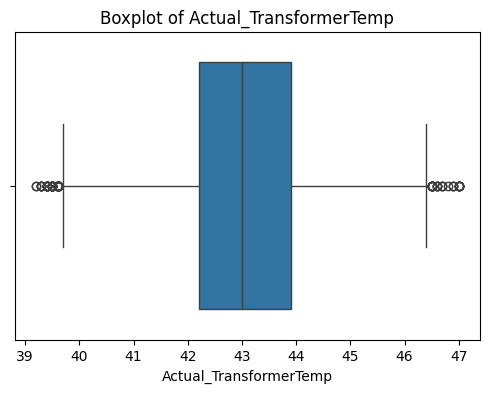

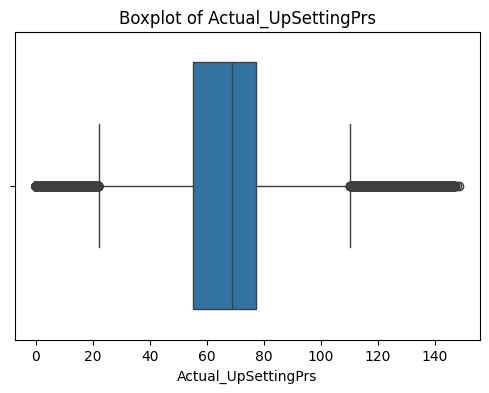

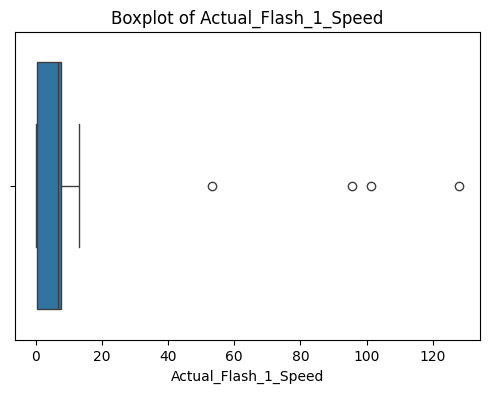

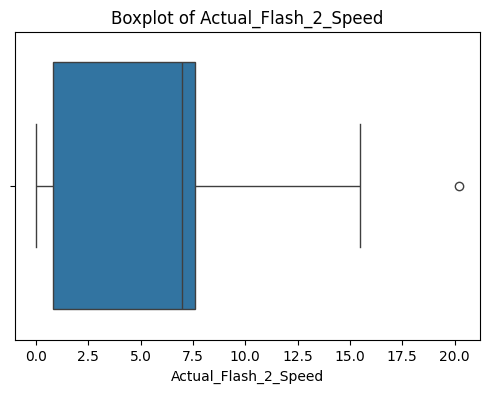

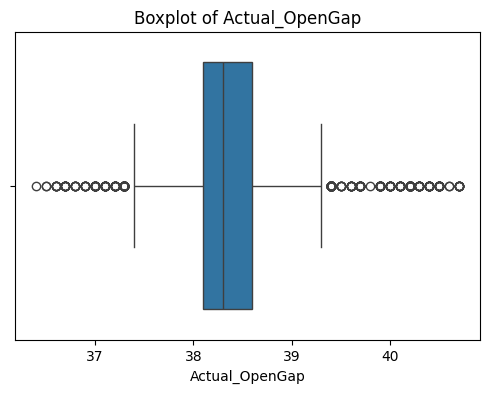

...

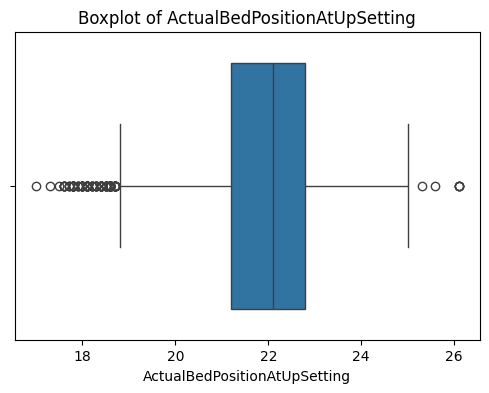

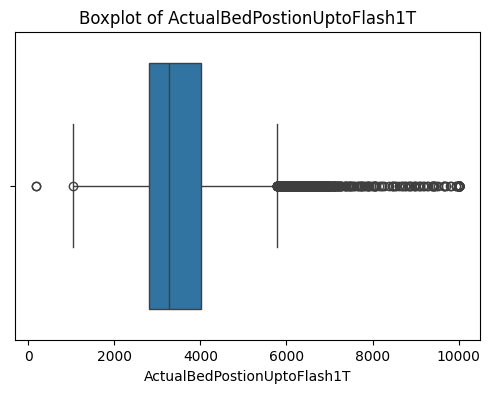

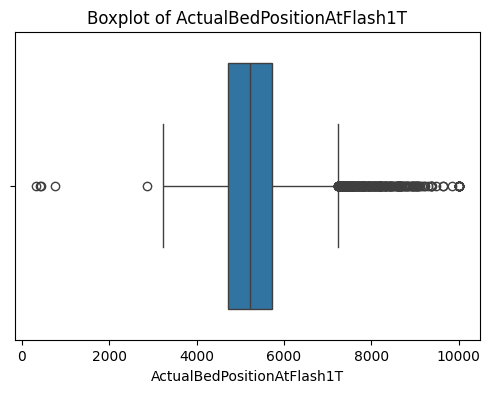

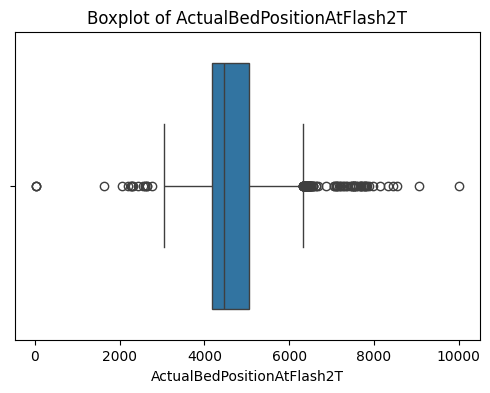

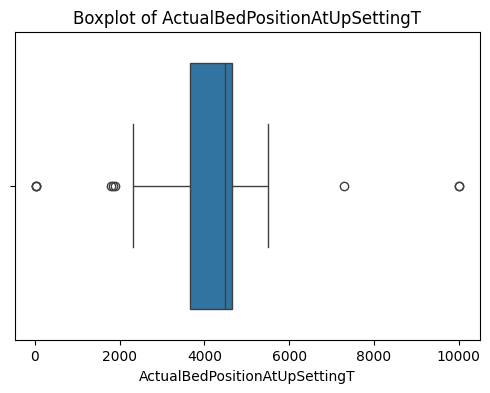

In [29]:
# --- Outlier detection using boxplot (for numeric columns) ---
num_cols = df.select_dtypes(include=['float64', 'int64']).columns
for col in num_cols[:16]:  # first 5 columns as example
    plt.figure(figsize=(6,4))
    sns.boxplot(x=df[col])
    plt.title(f"Boxplot of {col}")
    plt.show()

In [30]:
# Treating outliers using IQR method for one example column
for col in static_cols:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1

    lower_limit = Q1 - 1.5 * IQR
    upper_limit = Q3 + 1.5 * IQR

    outliers = df[(df[col] < lower_limit) | (df[col] > upper_limit)]
    print(f"Number of outliers in {col}: {len(outliers)}")

    df[col] = np.where(df[col] < lower_limit, lower_limit, np.where(df[col] > upper_limit, upper_limit, df[col]))



Number of outliers in Actual_TransformerTemp: 112
Number of outliers in Actual_UpSettingPrs: 6533
Number of outliers in Actual_Flash_1_Speed: 4
Number of outliers in Actual_Flash_2_Speed: 1
Number of outliers in Actual_OpenGap: 447
Number of outliers in Actual_Flash1Gap: 5041
Number of outliers in Actual_Flash2Gap: 14
Number of outliers in Actual_UpSetting: 39
Number of outliers in ActualBedPostionUptoFlash1: 379
Number of outliers in ActualBedPositionAtFlash1: 683
Number of outliers in ActualBedPositionAtFlash2: 45
Number of outliers in ActualBedPositionAtUpSetting: 202
Number of outliers in ActualBedPostionUptoFlash1T: 850
Number of outliers in ActualBedPositionAtFlash1T: 315
Number of outliers in ActualBedPositionAtFlash2T: 133
Number of outliers in ActualBedPositionAtUpSettingT: 9


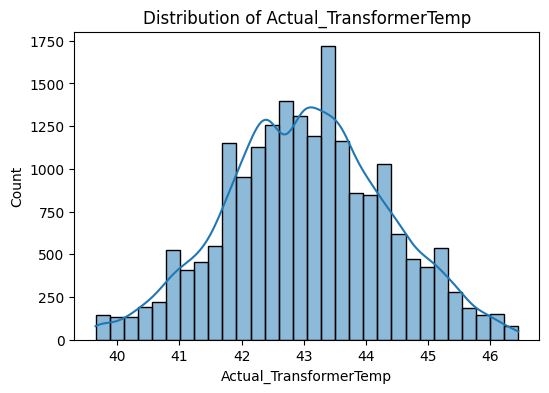

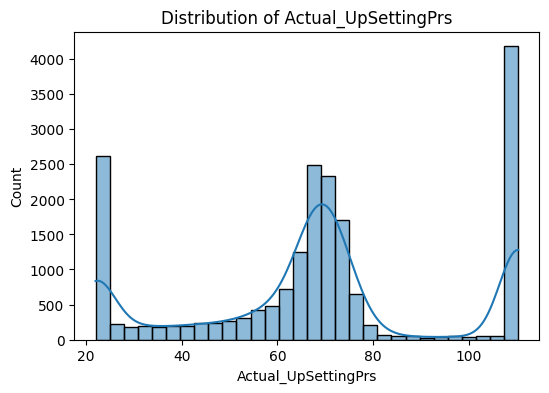

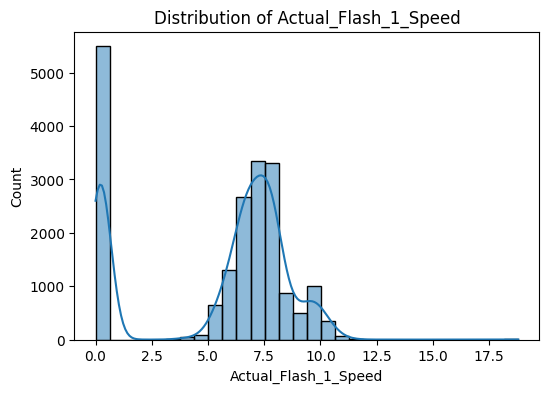

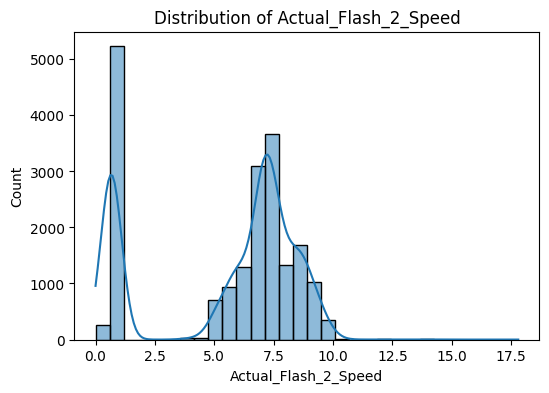

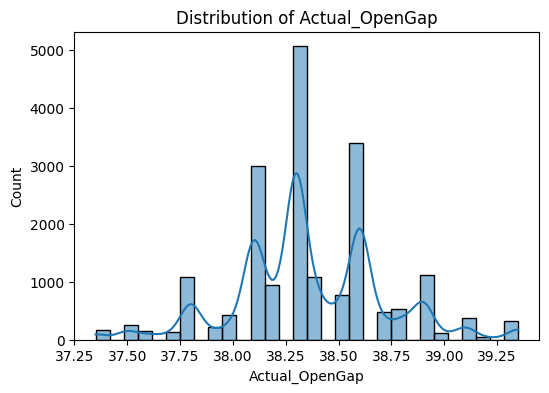

In [31]:
# --- Distribution plots (first 5 numeric columns) ---
for col in num_cols[:5]:
    plt.figure(figsize=(6,4))
    sns.histplot(df[col], bins=30, kde=True)
    plt.title(f"Distribution of {col}")
    plt.show()

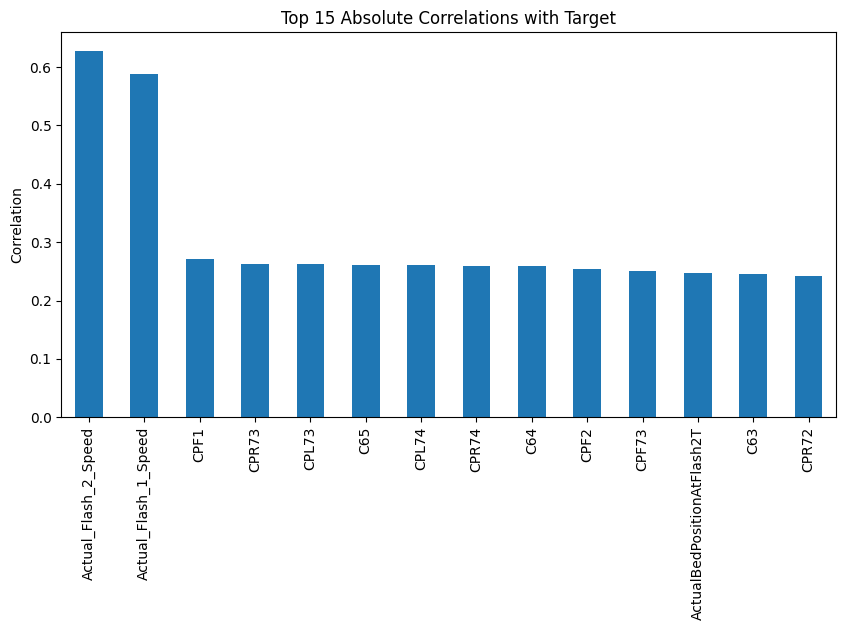

In [32]:
# --- Correlation with target bar chart ---
if 'iDefect' in df.columns:
    plt.figure(figsize=(10,5))
    corr['iDefect'].abs().sort_values(ascending=False)[1:15].plot(kind='bar')
    plt.title("Top 15 Absolute Correlations with Target")
    plt.ylabel("Correlation")
    plt.show()

In [33]:
from scipy.stats import skew, kurtosis

# Define time seiries signal groups
signals = {
    'C': [f'C{i}' for i in range(1, 81)],
    'CPL': [f'CPL{i}' for i in range(1, 81)],
    'CPR': [f'CPR{i}' for i in range(1, 81)],
    'CPF': [f'CPF{i}' for i in range(1, 81)]
}

# Feature extraction function
def extract_features(row, columns):
    values = row[columns].values.astype(float)
    features = {
        'mean': np.mean(values),
        'std': np.std(values),
        'min': np.min(values),
        'max': np.max(values),
        'median': np.median(values),
        'range': np.max(values) - np.min(values),
        'skew': skew(values),
        'kurtosis': kurtosis(values),
        'peak': np.max(np.abs(values)),  # maximum absolute value
        'auc': np.trapz(values)  # area under curve using trapezoidal rule
    }
    return pd.Series(features)

# Apply for each signal group
for signal_name, cols in signals.items():
    feature_df = df.apply(lambda row: extract_features(row, cols), axis=1)
    feature_df = feature_df.add_prefix(f"{signal_name}_")
    df = pd.concat([df, feature_df], axis=1)

# Drop original time-series columns (optional, if you only want features)
df.drop(columns=[col for group in signals.values() for col in group], inplace=True)

df = df.fillna(0)

# Save the processed dataset
df.to_csv("preprocessed_data.csv", index=False)

C:\Users\ASUS\AppData\Local\Temp\ipykernel_16280\2632417348.py:24: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  'auc': np.trapz(values)  # area under curve using trapezoidal rule
C:\Users\ASUS\AppData\Local\Temp\ipykernel_16280\2632417348.py:24: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  'auc': np.trapz(values)  # area under curve using trapezoidal rule
C:\Users\ASUS\AppData\Local\Temp\ipykernel_16280\2632417348.py:24: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  'auc': np.trapz(values)  # area under curve using trapezoidal rule
C:\Users\ASUS\AppData\Local\Temp\ipykernel_16280\2632417348.py:24: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in 